In [1]:
import numpy as np  
import pandas as pd 
import seaborn as sns 
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
data = pd.read_csv('C:/SREEHA/Desktop/Speed_dataset.csv')

In [3]:
data[['latitude','longitude','speed_mph','speedlimit_mph','functionalClass','isHighway']].corr()

,latitude,longitude,speed_mph,speedlimit_mph,functionalClass,isHighway
latitude,1.000000,0.379375,-0.052393,-0.037666,-0.036304,-0.029942
longitude,0.379375,1.000000,-0.012837,-0.005605,0.040911,0.023697
speed_mph,-0.052393,-0.012837,1.000000,0.675648,-0.724927,0.551639
speedlimit_mph,-0.037666,-0.005605,0.675648,1.000000,-0.624328,0.762467
functionalClass,-0.036304,0.040911,-0.724927,-0.624328,1.000000,-0.478363
isHighway,-0.029942,0.023697,0.551639,0.762467,-0.478363,1.000000


In [4]:
data[['latitude','longitude','speed_mph','speedlimit_mph','functionalClass','isHighway']].skew()

latitude           0.991016
longitude          0.057018
speed_mph         -0.267457
speedlimit_mph    -0.095338
functionalClass   -0.050771
isHighway         -0.789761
dtype: float64

In [5]:
data[['latitude','longitude','speed_mph','speedlimit_mph','functionalClass','isHighway']].describe()

,latitude,longitude,speed_mph,speedlimit_mph,functionalClass,isHighway
count,343628.000000,343628.000000,343628.000000,343628.000000,343628.000000,343628.000000
mean,35.504742,-78.495537,38.176129,54.442391,3.040398,0.683640
std,0.794903,0.910243,24.945979,10.014904,1.368529,0.465056
min,33.318760,-84.402771,1.000000,20.000000,0.000000,0.000000
25%,35.005116,-78.926933,10.000000,45.000000,2.000000,0.000000
50%,35.531018,-78.458893,44.000000,55.000000,3.000000,1.000000
75%,35.794942,-78.122360,64.000000,65.000000,4.000000,1.000000
max,38.641785,-75.599670,79.000000,70.000000,5.000000,1.000000


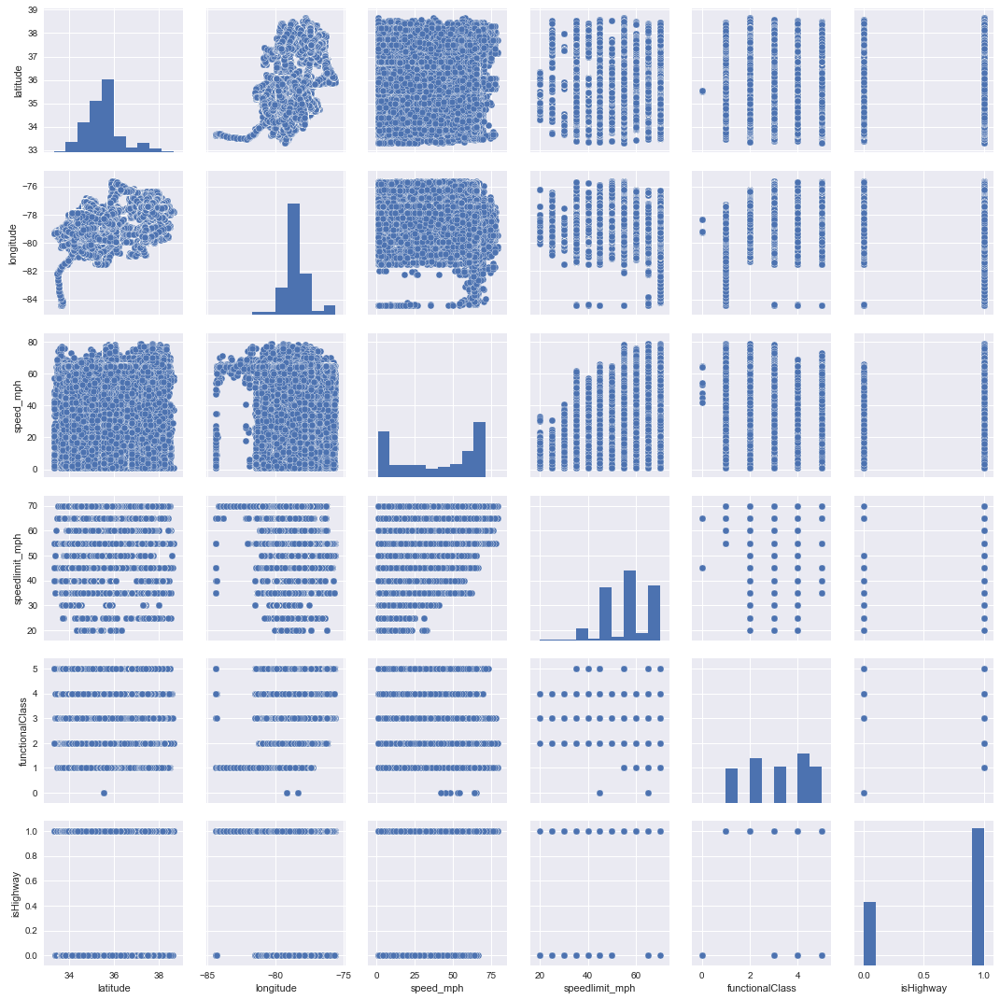

In [6]:
sns.pairplot(data=data,vars=('latitude','longitude','speed_mph','speedlimit_mph','functionalClass','isHighway'))

In [7]:
data_norm= data[['latitude','longitude','speed_mph','speedlimit_mph','functionalClass','isHighway']].apply(lambda x:(x-x.min())/(x.max()-x.min()))
data_norm

,latitude,longitude,speed_mph,speedlimit_mph,functionalClass,isHighway
0,0.248239,0.734292,0.807692,1.0,0.4,1.0
1,0.248913,0.734215,0.807692,1.0,0.4,1.0
2,0.231540,0.638200,0.000000,0.7,0.8,1.0
3,0.431128,0.673873,0.782051,1.0,0.4,1.0
4,0.431290,0.673411,0.769231,1.0,0.4,1.0
5,0.289564,0.727335,0.807692,1.0,0.4,1.0
6,0.189706,0.622135,0.282051,0.7,0.8,1.0
7,0.457969,0.647846,0.025641,0.7,1.0,1.0
8,0.203654,0.623175,0.820513,1.0,0.4,1.0
9,0.323272,0.710351,0.807692,1.0,0.4,1.0


In [8]:
df=pd.DataFrame(data) 

In [9]:
speed_range=df['speed_mph'].max()-df['speed_mph'].min()
speed_range

78

In [10]:
count_speed_violation=0
for i in range(2,322964):
    if df.speed_mph[i]<df.speedlimit_mph[i] and df.driver_id[i] != 0:
        count_speed_violation=count_speed_violation+1
        print(df.driver_id[i],  df.speedlimit_mph[i]-df.speed_mph[i],  df.timestamp[i])

916461 54 6/1/2015 0:04
1145487 8 6/1/2015 0:06
1145487 9 6/1/2015 0:06
5693 6 6/1/2015 0:19
500201 32 6/1/2015 0:24
1145487 52 6/1/2015 0:30
500201 5 6/1/2015 0:33
5693 6 6/1/2015 0:34
5693 6 6/1/2015 0:34
500201 6 6/1/2015 0:36
5693 6 6/1/2015 0:49
916461 28 6/1/2015 0:55
5693 5 6/1/2015 1:04
916461 3 6/1/2015 1:05
916461 28 6/1/2015 1:05
916461 2 6/1/2015 1:05
1145487 39 6/1/2015 1:13
500201 5 6/1/2015 1:18
1145487 3 6/1/2015 1:21
500201 1 6/1/2015 1:34
916461 5 6/1/2015 1:35
916461 5 6/1/2015 1:35
1145487 25 6/1/2015 1:35
1145487 17 6/1/2015 1:36
1145487 15 6/1/2015 1:36
1145487 53 6/1/2015 1:39
5693 25 6/1/2015 1:50
5693 33 6/1/2015 2:04
5693 16 6/1/2015 2:04
500201 54 6/1/2015 2:10
1145487 16 6/1/2015 2:12
916461 11 6/1/2015 2:20
5693 8 6/1/2015 2:34
5693 8 6/1/2015 2:34
500201 7 6/1/2015 2:37
5693 6 6/1/2015 2:49
916461 22 6/1/2015 2:49
916461 7 6/1/2015 2:50
1145487 37 6/1/2015 3:03
5693 5 6/1/2015 3:04
5693 6 6/1/2015 3:04
916461 4 6/1/2015 3:05
1145487 12 6/1/2015 3:05
916461

In [11]:
for i in range(343628):
    if df.speed_mph[i]<df.speedlimit_mph[i] and df.isHighway[i]==1 and df.driver_id[i] != 0:
        print(df.driver_id[i],df.vehicle_id[i])

5693 1208979
5693 1208979
916461 1262441
1145487 1280223
1145487 1280223
5693 1208979
500201 550280
1145487 1280223
500201 550280
5693 1208979
5693 1208979
500201 550280
5693 1208979
916461 1262441
5693 1208979
500201 550280
1145487 1280223
500201 550280
916461 1262441
916461 1262441
1145487 1280223
500201 550280
916461 1262441
5693 1208979
5693 1208979
5693 1208979
5693 1208979
5693 1208979
916461 1262441
916461 1262441
1145487 534766
500201 550280
5693 1208979
1145487 534766
1145487 534766
5693 1208979
5693 1208979
5693 1208979
1145487 534766
500201 550280
916461 1262441
500201 550280
5693 1208979
1145487 534766
1145487 534766
1145487 534766
4276 567435
4276 567435
4276 567435
500201 550280
500201 550280
4276 567435
500201 550280
5693 1208979
5693 1208979
916461 1262441
916461 1262441
4276 567435
500201 550280
1145487 534766
5693 1208979
1145487 534766
4276 567435
1145487 534766
4276 567435
500201 550280
5693 1208979
5693 1208979
1145487 534766
4276 567435
5693 1208979
4276 567435
42

In [12]:
for i in range(343628):
    if df.speed_mph[i]<df.speedlimit_mph[i] and df.isHighway[i]==0 and df.driver_id[i] != 0:
        print(df.driver_id[i],df.vehicle_id[i])

916461 1262441
916461 1262441
916461 1262441
1145487 1280223
1145487 1280223
1145487 1280223
1145487 1280223
5693 1208979
5693 1208979
5693 1208979
1145487 1280223
500201 550280
916461 1262441
916461 1262441
1145487 534766
1145487 534766
500201 550280
916461 1262441
500201 550280
500201 550280
916461 1262441
5693 1208979
5693 1208979
916461 1262441
1145487 534766
500201 550280
916461 1262441
500201 550280
916461 1262441
5693 1208979
916461 1262441
916461 1262441
916461 1262441
4276 567435
4276 567435
4276 567435
4276 567435
4276 567435
342321 550764
466293 1444
466293 1444
4276 567435
466293 1444
466293 1444
342321 550764
1145487 534766
5687 550766
5687 550766
5687 550766
5687 550766
4276 567435
342321 550764
342321 550764
342321 550764
4276 567435
4276 567435
213257 1462
213257 1462
213257 1462
4278 530030
38719 1207151
38719 1207151
342321 550764
1065377 534766
524221 1434981
4278 530030
4278 530030
4278 530030
714485 550280
524221 1434981
4278 530030
714485 550280
714485 550280
4278

In [13]:
for i in range(343628):
    if df.speed_mph[i]>df.speedlimit_mph[i] and df.driver_id[i] != 0:
        print(df.driver_id[i],df.vehicle_id[i])

5693 1208979
916461 1262441
5693 1208979
1145487 1280223
1145487 1280223
1145487 534766
500201 550280
1145487 534766
500201 550280
5693 1208979
466293 1444
1145487 534766
4276 567435
4276 567435
342321 550764
1145487 534766
466293 1444
466293 1444
991329 88250
1159791 1207169
55563 550768
55563 550768
54397 535024
55563 550768
54397 535024
55563 550768
54397 535024
991329 88250
4276 567435
54397 535024
342321 550764
54397 535024
55563 550768
524221 1434981
524221 1434981
65743 1191293
54397 535024
55563 550768
54397 535024
812033 535412
991329 88250
714485 550280
5687 550766
991329 88250
732669 550272
732669 550272
714485 550280
65743 1191293
2132 1173291
8459 1280225
213257 1462
8459 1280225
213257 1462
466293 1444
714485 550280
38719 1207151
40451 528616
1159791 1207169
991329 88250
991329 88250
39251 1173169
39251 1173169
39251 1173169
322085 1351613
732669 550272
55563 550768
4287 1171973
4287 1171973
1159793 88697
1159793 88697
322085 1351613
322085 1351613
1091309 567437
1091309 

In [14]:
for i in range(343628):
    if df.speed_mph[i]>df.speedlimit_mph[i] and df.isHighway[i]==0 and df.driver_id[i] != 0:
        print(df.driver_id[i],df.vehicle_id[i])

5693 1208979
1145487 534766
4276 567435
4276 567435
1145487 534766
714485 550280
40451 528616
1159791 1207169
991329 88250
991329 88250
55563 550768
1159791 1207169
466293 1444
884137 567435
183927 1202269
1159791 1207169
55563 550768
55563 550768
38719 1207151
1065377 534766
884137 567435
65743 1191293
884137 567435
812033 535412
732669 550272
732669 550272
1065377 534766
812033 535412
39251 1173169
39251 1173169
40451 528616
882873 90560
40451 528616
40450 567067
40450 567067
65743 1191293
65743 1191293
40451 528616
500201 1207151
322085 1351613
40450 567067
997291 1280223
992205 1173169
916461 1262441
916461 1262441
1163537 1190543
1163537 1190543
1163537 1190543
916461 1262441
466293 1444
466293 1444
466293 1444
466293 1444
1159791 550764
4282 1207169
55563 550768
14675 1208431
524221 1434981
1091309 567437
40451 528616
322085 1351613
322085 1351613
4282 1207169
40451 528616
40450 567067
4282 1207169
1159791 550764
524221 1434981
40451 528616
322085 1351613
322085 1351613
812033 53

In [15]:
count_speed_violation

223773

In [16]:
dr=df[df.driver_id!=0]
#dr_f=set(dr.driver_id)
#unique_dr=list(dr_f)
#unique_dr

In [17]:
import array
count_vio=[0]*343628
for i in range(2,343628):
    count_driv_vio=0
    if df.speed_mph[i]>df.speedlimit_mph[i] and df.driver_id[i]!=0:
        count_vio[i]=count_driv_vio+1   
        print(df.driver_id[i],count_vio[i])

5693 1
916461 1
5693 1
1145487 1
1145487 1
1145487 1
500201 1
1145487 1
500201 1
5693 1
466293 1
1145487 1
4276 1
4276 1
342321 1
1145487 1
466293 1
466293 1
991329 1
1159791 1
55563 1
55563 1
54397 1
55563 1
54397 1
55563 1
54397 1
991329 1
4276 1
54397 1
342321 1
54397 1
55563 1
524221 1
524221 1
65743 1
54397 1
55563 1
54397 1
812033 1
991329 1
714485 1
5687 1
991329 1
732669 1
732669 1
714485 1
65743 1
2132 1
8459 1
213257 1
8459 1
213257 1
466293 1
714485 1
38719 1
40451 1
1159791 1
991329 1
991329 1
39251 1
39251 1
39251 1
322085 1
732669 1
55563 1
4287 1
4287 1
1159793 1
1159793 1
322085 1
322085 1
1091309 1
1091309 1
1159791 1
40451 1
1159793 1
1159791 1
2132 1
466293 1
5687 1
5687 1
40451 1
40451 1
882873 1
8459 1
8459 1
882873 1
55563 1
55563 1
4278 1
2132 1
882873 1
8459 1
54397 1
55563 1
4278 1
991329 1
4278 1
213257 1
213257 1
812033 1
55563 1
812033 1
65743 1
991329 1
991329 1
466293 1
213257 1
991329 1
38719 1
884137 1
714485 1
714485 1
38719 1
5687 1
183927 1
991329 1
8

In [18]:
d={'count':count_vio,'driver_id':df.driver_id}
data_f=pd.DataFrame(d)
data_f

,count,driver_id
0,0,5693
1,0,5693
2,0,916461
3,0,1145487
4,0,1145487
5,0,5693
6,0,500201
7,0,1145487
8,0,500201
9,0,5693


In [19]:
vio=pd.DataFrame(data_f.groupby(['driver_id']).sum().reset_index())
vio

,driver_id,count
0,0,0
1,2132,1041
2,4276,168
3,4278,864
4,4282,1075
5,4284,247
6,4287,1199
7,5687,967
8,5693,938
9,6534,852


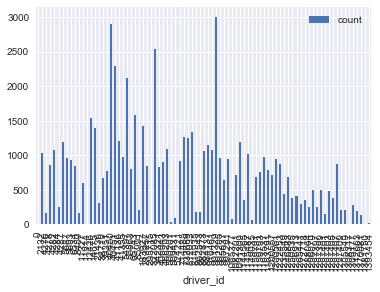

In [20]:
vio.plot.bar(x='driver_id',y='count')

C:\Users\LHAVANYA\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:51: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  return getattr(obj, method)(*args, **kwds)


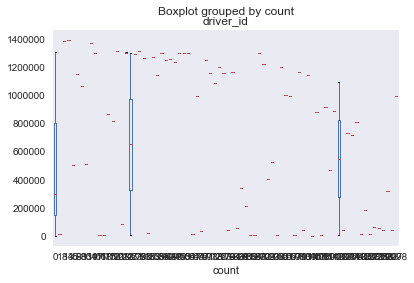

In [21]:
vio.boxplot(by ='count', column =['driver_id'], grid = False) 

In [22]:
import array
count_nonvio=[0]*343628
for i in range(2,343628):
    count_driv_nonvio=0
    if df.speed_mph[i]<=df.speedlimit_mph[i] and df.driver_id[i]!=0:
        count_nonvio[i]=count_driv_nonvio+1   
        print(df.driver_id[i],count_nonvio[i])

916461 1
1145487 1
1145487 1
5693 1
500201 1
1145487 1
500201 1
5693 1
5693 1
500201 1
500201 1
5693 1
916461 1
500201 1
500201 1
5693 1
916461 1
916461 1
916461 1
1145487 1
500201 1
1145487 1
500201 1
500201 1
916461 1
916461 1
1145487 1
1145487 1
1145487 1
1145487 1
500201 1
916461 1
5693 1
500201 1
500201 1
5693 1
5693 1
916461 1
916461 1
500201 1
1145487 1
916461 1
5693 1
5693 1
500201 1
5693 1
916461 1
916461 1
1145487 1
5693 1
5693 1
916461 1
1145487 1
916461 1
500201 1
1145487 1
500201 1
5693 1
1145487 1
1145487 1
5693 1
916461 1
5693 1
500201 1
5693 1
1145487 1
500201 1
916461 1
500201 1
500201 1
916461 1
500201 1
5693 1
5693 1
5693 1
916461 1
1145487 1
500201 1
916461 1
1145487 1
1145487 1
1145487 1
500201 1
500201 1
500201 1
916461 1
5693 1
4276 1
4276 1
4276 1
500201 1
500201 1
4276 1
500201 1
5693 1
5693 1
916461 1
916461 1
4276 1
500201 1
1145487 1
5693 1
1145487 1
4276 1
1145487 1
1145487 1
4276 1
500201 1
5693 1
5693 1
916461 1
916461 1
916461 1
1145487 1
4276 1
5693 1
4

In [23]:
dt={'count_nonvio':count_nonvio,'nonvio_driver_id':df.driver_id}
dt_f=pd.DataFrame(dt)
dt_f

,count_nonvio,nonvio_driver_id
0,0,5693
1,0,5693
2,1,916461
3,1,1145487
4,1,1145487
5,1,5693
6,1,500201
7,1,1145487
8,1,500201
9,1,5693


In [24]:
nonvio=pd.DataFrame(dt_f.groupby(['nonvio_driver_id']).sum().reset_index())
nonvio

,nonvio_driver_id,count_nonvio
0,0,0
1,2132,3468
2,4276,3038
3,4278,5028
4,4282,3526
5,4284,2431
6,4287,5127
7,5687,6391
8,5693,4375
9,6534,4108


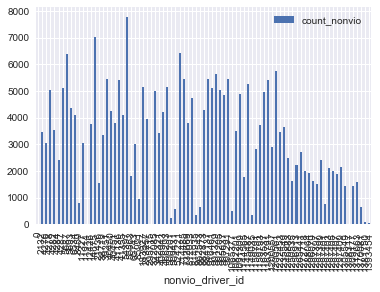

In [25]:
nonvio.plot.bar(x='nonvio_driver_id',y='count_nonvio')

In [26]:
sp=[0]*343628
for i in range(343628):
    if df.isHighway[i]==1:
        sp[i]=df.speed_mph[i]
print(sp)

[64, 64, 1, 62, 61, 64, 23, 3, 65, 64, 64, 64, 65, 64, 27, 65, 65, 65, 50, 0, 0, 0, 0, 65, 62, 52, 65, 64, 65, 65, 0, 0, 0, 2, 65, 65, 0, 65, 65, 0, 0, 65, 65, 1, 0, 0, 34, 65, 62, 62, 0, 64, 0, 0, 65, 0, 0, 65, 64, 66, 0, 63, 0, 73, 66, 62, 64, 64, 64, 65, 64, 0, 65, 0, 2, 0, 2, 0, 0, 65, 64, 3, 1, 0, 0, 2, 0, 0, 0, 0, 7, 3, 3, 65, 65, 0, 0, 0, 6, 51, 51, 12, 65, 52, 65, 64, 63, 64, 64, 64, 63, 30, 64, 9, 64, 64, 65, 64, 65, 64, 64, 0, 0, 0, 0, 0, 0, 65, 64, 65, 64, 0, 0, 0, 26, 8, 9, 34, 64, 64, 65, 8, 0, 0, 0, 0, 8, 0, 0, 38, 74, 66, 62, 0, 0, 29, 0, 0, 28, 63, 64, 0, 64, 0, 0, 0, 0, 63, 67, 4, 63, 0, 0, 0, 66, 0, 0, 0, 67, 64, 65, 65, 7, 65, 0, 65, 66, 66, 0, 0, 0, 0, 0, 0, 0, 0, 65, 52, 0, 0, 64, 0, 0, 13, 7, 8, 22, 64, 28, 4, 39, 0, 0, 17, 1, 0, 0, 64, 64, 64, 0, 0, 0, 0, 13, 0, 0, 9, 2, 34, 64, 0, 65, 65, 0, 46, 65, 60, 3, 0, 0, 0, 64, 0, 0, 64, 0, 11, 0, 0, 0, 0, 65, 65, 65, 65, 65, 65, 0, 0, 65, 61, 57, 0, 0, 65, 0, 46, 0, 63, 58, 0, 0, 0, 0, 65, 62, 27, 6, 65, 61, 22, 0, 7, 0

In [27]:
max(sp)

79

In [28]:
sp1=[0]*343628
for i in range(343628):
    if df.isHighway[i]==0:
        sp1[i]=df.speed_mph[i]
print(sp1)

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 32, 7, 33, 6, 0, 0, 0, 0, 0, 0, 0, 20, 28, 30, 0, 0, 0, 20, 0, 0, 12, 24, 0, 0, 0, 29, 43, 0, 0, 0, 0, 28, 0, 23, 38, 0, 1, 8, 0, 0, 0, 33, 0, 24, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 3, 0, 41, 0, 2, 11, 0, 0, 0, 0, 19, 36, 0, 25, 25, 26, 2, 0, 0, 0, 0, 0, 4, 23, 23, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 6, 25, 5, 7, 1, 0, 0, 0, 0, 3, 7, 1, 0, 0, 0, 0, 0, 0, 0, 0, 17, 6, 5, 8, 0, 2, 44, 0, 0, 0, 0, 39, 37, 0, 22, 1, 0, 0, 0, 4, 0, 30, 11, 48, 47, 0, 0, 0, 0, 26, 48, 14, 0, 8, 6, 5, 0, 0, 0, 0, 0, 0, 34, 0, 0, 0, 6, 8, 24, 24, 2, 12, 21, 2, 0, 0, 2, 2, 0, 25, 4, 0, 0, 0, 0, 0, 0, 0, 0, 21, 2, 0, 0, 6, 1, 0, 0, 0, 2, 3, 23, 5, 0, 7, 34, 0, 0, 0, 0, 2, 0, 0, 32, 0, 0, 0, 0, 8, 5, 5, 0, 6, 1, 0, 25, 0, 3, 30, 2, 20, 0, 0, 0, 0, 0, 0, 26, 1, 0, 0, 0, 39, 1, 0, 4, 0, 14, 0, 0, 31, 1, 4, 44, 0, 0, 0, 0, 0, 0, 0, 7, 0, 20, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 6, 4, 0, 0, 0, 0, 0, 6, 6, 0, 12, 0, 0, 6, 1, 3, 

In [29]:
max(sp1)

66

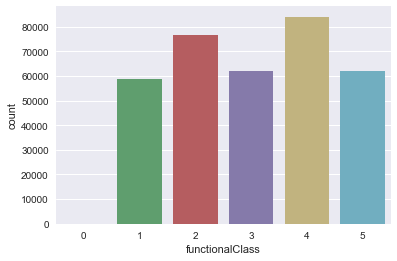

In [30]:
sns.countplot(x='functionalClass',data=df)